
===================================================================================================

==================================================================================================

- author : Sylvie
- date   : March 7th th 2018
- update : 
- Version. : 1.0




# Initialisation of the notebook

In [55]:
from IPython.core.display import HTML
def css_styling():
    styles = open("../../styles/custom.css", "r").read()
    return HTML(styles)
css_styling()

In [56]:
theNotebook="FindCentralStarPosition"

In [57]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

print theNotebook
from IPython.display import Image, display
import sys
sys.path.append("../../common_tools/")
from common_notebook import *

init_notebook()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
FindCentralStarPosition
ccdproc version 1.3.0
bottleneck version 1.2.1
/pbs/throng/lsst/users/dagoret/GitHubatCC/CTIOAnaJun2017/ana_30may17/HD111980


In [58]:
from astropy.modeling import models, fitting

In [59]:
import pandas as pd

In [60]:
plt.rcParams.update({'figure.max_open_warning': 0})

## Input directory

- specify which are the input images

In [61]:
#inputdir="/Users/dagoret/DATA/CTIODataJune2017_reducedRed/data_30may17"
inputdir="/sps/lsst/data/AtmosphericCalibration/CTIODataJune2017_reducedRed/data_30may17"
MIN_IMGNUMBER=58
MAX_IMGNUMBER=190
date="20170530"
object_name='HD111980'
tag = "reduc"
SelectTagRe='^%s_%s_([0-9]+).fits$' % (tag,date) # regular expression to select the file
SearchTagRe='^%s_%s_[0-9]+.fits$' % (tag,date)
NBIMGPERROW=2

## Output directory

- specify where are stored the cut images as well as the plot produced

In [62]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images
ensure_dir(dir_top_images) # create that directory

outputdir="./cut_fitsimages_2"
ensure_dir(outputdir)

## End of mandatory initialisation

-------------------------------------------------------
# Now  skip to the section to be re-run
-------------------------------------------------------


- Section 1: Find the central star and cut the image around the the dispersed spectrum
- Section 2 : find the dispersion axis angle of rotation wrt X-axis and apply the rotation
- Section 3 : Check with 1D spectrum

# Section 1 : Find the central star and cut the image around the the dispersed spectrum

## Read of the image spectra

In [63]:
dirlist_all = [inputdir] # only one directory to process
sorted_numbers,sorted_files = MakeFileList(dirlist_all,MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 
all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt,all_filt1,all_filt2=BuildImages(sorted_files,sorted_numbers,object_name)
print 'Number of images:',len(all_images)

Number of images: 133


## Sort the index according the disperser type



### tabulated disperser-filters

- in common_notebook

In [64]:
print Filt_names

['dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron200', 'Unknown']


### filter-disperser in our data

- check the filter names are inside Filt_names

In [65]:
print all_filt

['dia Thor300', 'dia Thor300', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg

In [66]:
print all_filt1

['dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia', 'dia']


In [67]:
print all_filt2

['Thor300', 'Thor300', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg', 'Ron400', 'Thor300', 'Hol

###  Do the disperser sorting



In [68]:
filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx,filt6_idx=get_filt_idx(all_filt)

### Check the sorting result

In [69]:
print  Filt_names[0],' \t : filt0_idx :: ',filt0_idx
print  Filt_names[1],' \t : filt1_idx :: ',filt1_idx
print  Filt_names[2],' \t : filt2_idx :: ',filt2_idx
print  Filt_names[3],' \t : filt3_idx :: ',filt3_idx
print  Filt_names[4],' \t : filt4_idx :: ',filt4_idx
print  Filt_names[5],' \t : filt5_idx :: ',filt5_idx
print  Filt_names[6],' \t : filt6_idx :: ',filt6_idx

dia Ron400  	 : filt0_idx ::  [  2   7  12  17  22  27  32  37  42  47  52  57  62  67  72  77  82  87
  92  97 102 107 112 117 122 127 132]
dia Thor300  	 : filt1_idx ::  [  0   1   3   8  13  18  23  28  33  38  43  48  53  58  63  68  73  78
  83  88  93  98 103 108 113 118 123 128]
dia HoloPhP  	 : filt2_idx ::  [  4   9  14  19  24  29  34  39  44  49  54  59  64  69  74  79  84  89
  94  99 104 109 114 119 124 129]
dia HoloPhAg  	 : filt3_idx ::  [  5  10  15  20  25  30  35  40  45  50  55  60  65  70  75  80  85  90
  95 100 105 110 115 120 125 130]
dia HoloAmAg  	 : filt4_idx ::  [  6  11  16  21  26  31  36  41  46  51  56  61  66  71  76  81  86  91
  96 101 106 111 116 121 126 131]
dia Ron200  	 : filt5_idx ::  []
Unknown  	 : filt6_idx ::  []


## Example for one raw image


- the idea is to check where is the center of the main star
- size 2k x 2 K

In [70]:
# select the index
sel_index=0

Text(1000,1700,u'dia Thor300')

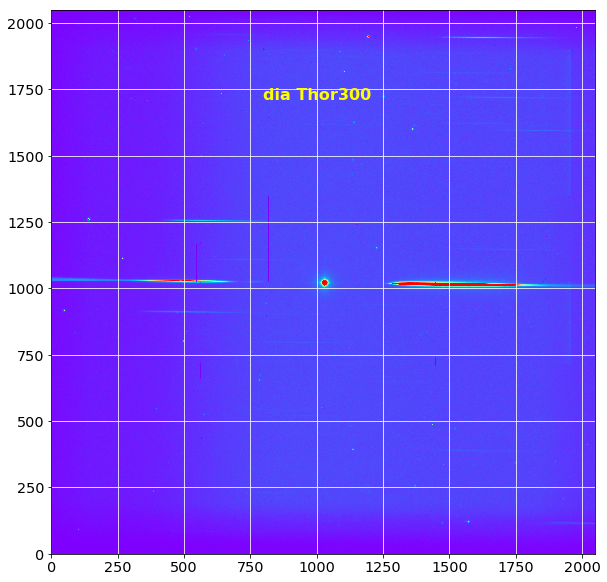

In [71]:
plt.figure(figsize=(10,10))
plt.imshow(all_images[sel_index],origin='lower',cmap='rainbow',vmin=0, vmax=2000)
plt.grid(color='white', ls='solid')
plt.text(1000.,1700,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

### Try to fit a 2D gaussian

- Fit a 2D gaussian on intensity of central star


we have to paly with the parameter below to find a common region to find the central star

In [72]:
# first rough estimate of the maximum
x0,y0=guess_init_fit(all_images[sel_index],500,1100,500,1100)

In [73]:
dw=200  # width

In [74]:
print "x0,y0=",x0,y0

x0,y0= 1030 1026


In [75]:
# cut the subimage
cropped_image=np.copy(all_images[sel_index][y0-dw:y0+dw,x0-dw:x0+dw])

In [76]:
NY=cropped_image.shape[0]
NX=cropped_image.shape[1]

In [77]:
# build a mesh grid of x-y
y, x = np.mgrid[:NY,:NX]

In [78]:
z=cropped_image[y,x]

### Show the pre-selected subimage

Text(100,100,u'dia Thor300')

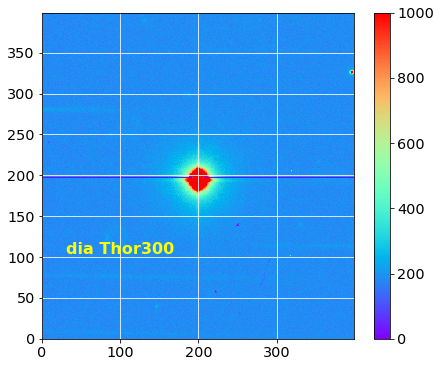

In [79]:
# plot x,y,z
plt.figure(figsize=(7,6))
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.text(100.,100,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

In [80]:
x_mean=NX/2
y_mean=NY/2
z_max=z[y_mean,x_mean]
print x_mean,y_mean,z_max

200 200 57701.04673185378


### Make the 2D fit

In [81]:
p_init = models.Gaussian2D(amplitude=z_max,x_mean=x_mean,y_mean=y_mean)
fit_p = fitting.LevMarLSQFitter()

In [82]:
import warnings
p = fit_p(p_init, x, y, z)

In [83]:
print p.x_mean
print p.y_mean
print p.amplitude

Parameter('x_mean', value=200.048221534)
Parameter('y_mean', value=194.560409905)
Parameter('amplitude', value=79435.914155)


In [84]:
new_x0=p.x_mean
new_y0=p.y_mean

### Show result of 2D gaussian fit

Text(0.5,1,u'Residual')

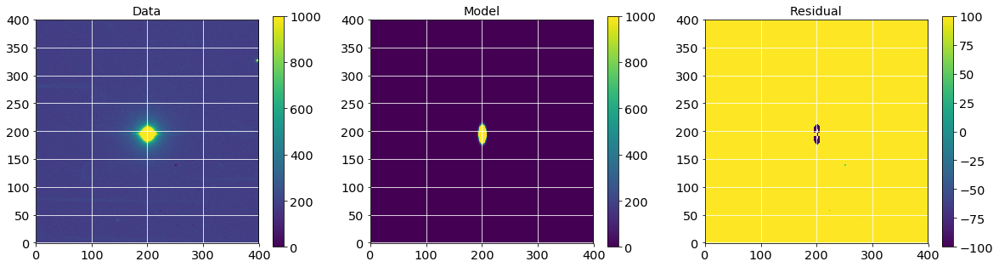

In [85]:
plt.figure(figsize=(20, 5))
#subplot 1
plt.subplot(1, 3, 1)
plt.imshow(z, origin='lower', interpolation='nearest', vmin=0, vmax=1000)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.title("Data")
#subplot 2
plt.subplot(1, 3, 2)
plt.imshow(p(x, y), origin='lower', interpolation='nearest', vmin=0,vmax=1000)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.title("Model")
#subplot 3
plt.subplot(1, 3, 3)
plt.imshow(z - p(x, y), origin='lower', interpolation='nearest', vmin=-100,vmax=100)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.title("Residual")

### Check the result of the fit

- the center of the star is where it is expected (black point)

Text(100,100,u'dia Thor300')

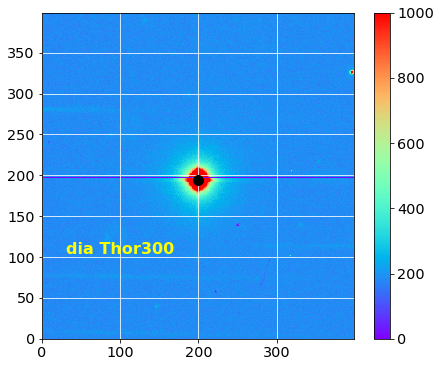

In [86]:
plt.figure(figsize=(7,6))
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.plot([new_x0],[new_y0],'ko',markersize=10)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.text(100.,100,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

## Show the images at Input

- So now work on the series of the images

- First look at them
- notice there is a downsampling factor of 10

Processing image 0...
Processing image 1...
Processing image 2...
Processing image 3...
Processing image 4...
Processing image 5...
Processing image 6...
Processing image 7...
Processing image 8...
Processing image 9...
Processing image 10...
Processing image 11...
Processing image 12...
Processing image 13...
Processing image 14...
Processing image 15...
Processing image 16...
Processing image 17...
Processing image 18...
Processing image 19...
Processing image 20...
Processing image 21...
Processing image 22...
Processing image 23...
Processing image 24...
Processing image 25...
Processing image 26...
Processing image 27...
Processing image 28...
Processing image 29...
Processing image 30...
Processing image 31...
Processing image 32...
Processing image 33...
Processing image 34...
Processing image 35...
Processing image 36...
Processing image 37...
Processing image 38...
Processing image 39...
Processing image 40...
Processing image 41...
Processing image 42...
Processing image 43..

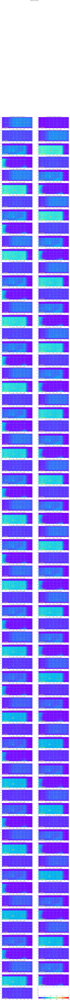

In [87]:
ShowImages(all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=1000,downsampling=10,verbose=True)
figfilename=os.path.join(dir_top_images,'input_images.pdf')
plt.savefig(figfilename)   

## Show the histograms of input images

- just check the reduction and deflattage is OK

In [88]:
#ShowHistograms(all_images,all_titles,all_filt,object_name,
#               NBIMGPERROW=2,bins=100,range=(-50,10000),downsampling=10,verbose=True)

##  Guess central position of the central star in original image

- defines two utility functions


### Compute the position of central star

** Please the the area for the central star here **

- This is very important to predefine here the region where you expect the order 0 bright central star.
- Check below if the pre-selection allow to target the right bright star

In [89]:
# guess the region where the maximum is
#Delta_x0=[750,1000]
#Delta_y0=[500,750]
#dwc=125

Delta_x0=[500,1100]
Delta_y0=[500,1100]
dwc=200

x_guess,y_guess=guess_central_position(all_images,Delta_x0,Delta_y0,dwc,filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx,filt6_idx)

0 : (x_guess,y_guess)= 1030.048221534158 1020.5604099050762
1 : (x_guess,y_guess)= 778.0339465966767 701.4379798402791
2 : (x_guess,y_guess)= 780.487914857524 702.0666382218085
3 : (x_guess,y_guess)= 780.260692196505 702.0882152319966
4 : (x_guess,y_guess)= 780.2246335536236 701.0041451410254
5 : (x_guess,y_guess)= 780.6354754615211 701.3340280788753
6 : (x_guess,y_guess)= 780.2798747427429 700.4620186001962
7 : (x_guess,y_guess)= 778.6759858221626 700.7946019368984
8 : (x_guess,y_guess)= 778.7725538962196 701.9449834010026
9 : (x_guess,y_guess)= 778.0299024575002 700.9912940607193
10 : (x_guess,y_guess)= 778.9939776553715 700.8810492028767
11 : (x_guess,y_guess)= 778.0104265407977 699.6960698485955
12 : (x_guess,y_guess)= 776.2368125482391 700.120787954756
13 : (x_guess,y_guess)= 775.8206539122895 700.2269156850448
14 : (x_guess,y_guess)= 776.2639370981316 697.2481699590558
15 : (x_guess,y_guess)= 776.6528942422917 697.2499774127698
16 : (x_guess,y_guess)= 774.8943485153676 698.107204

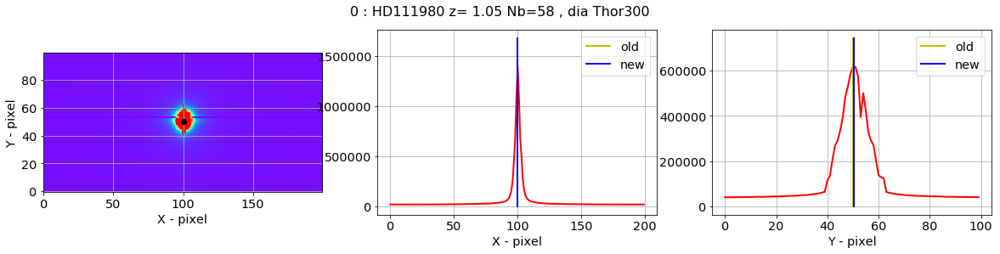

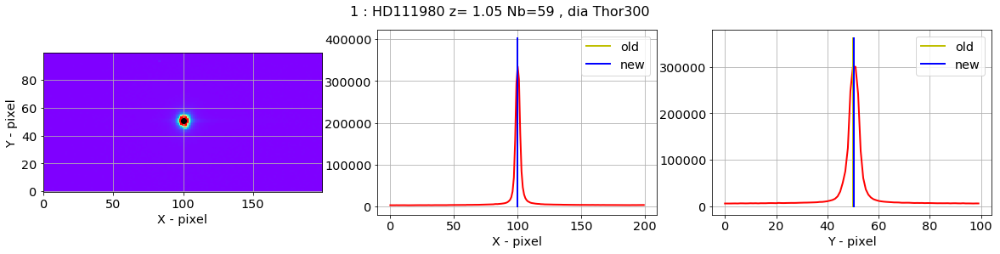

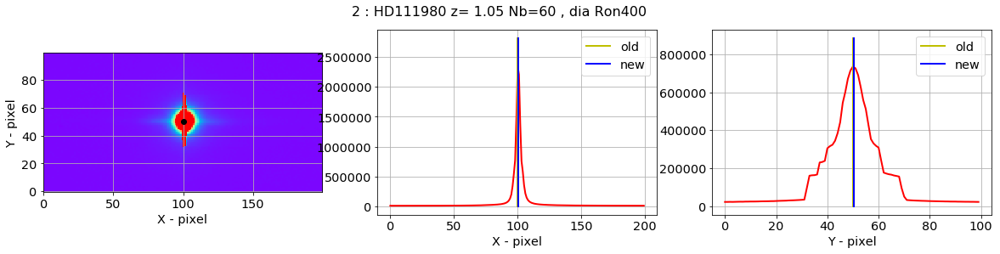

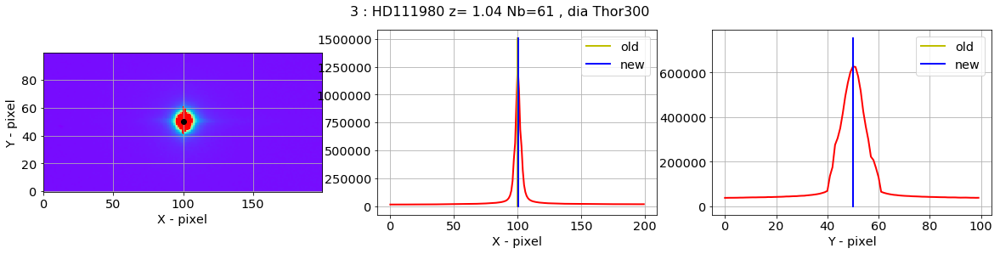

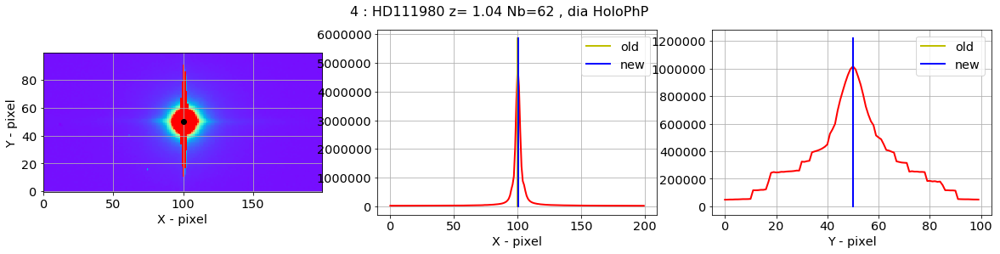

...

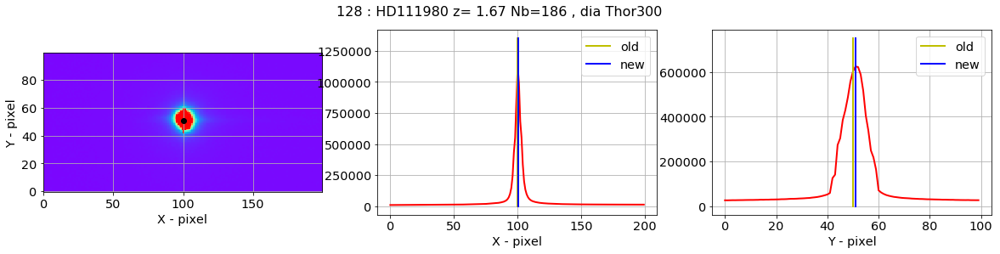

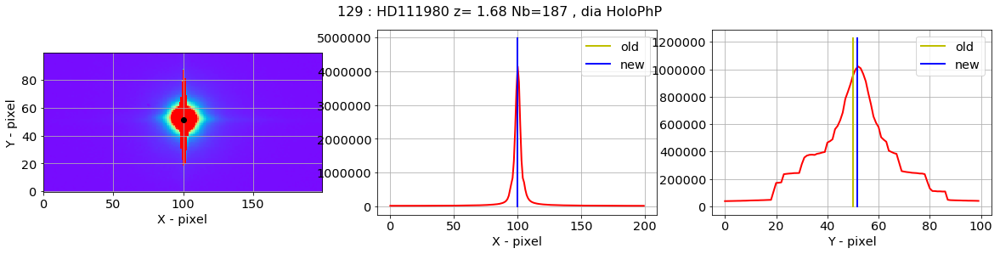

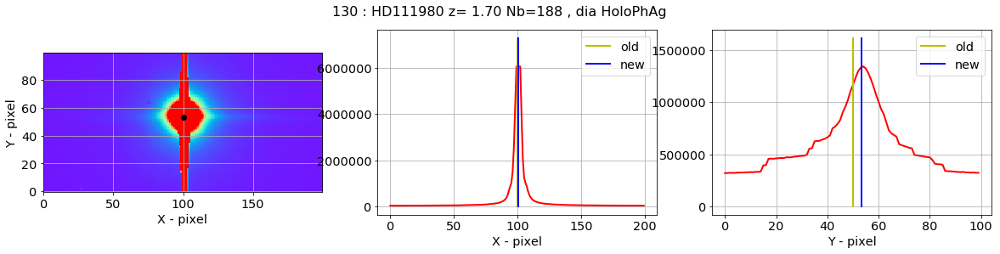

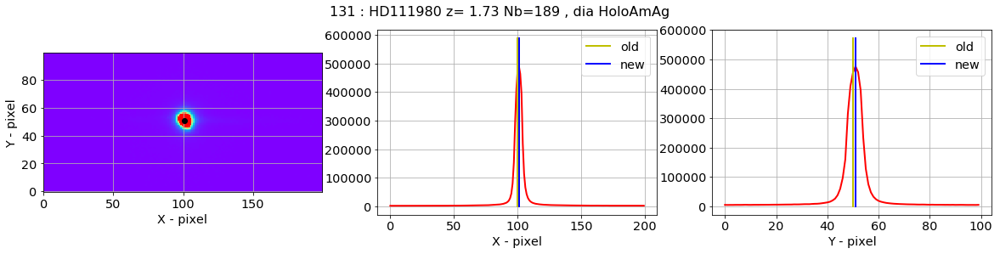

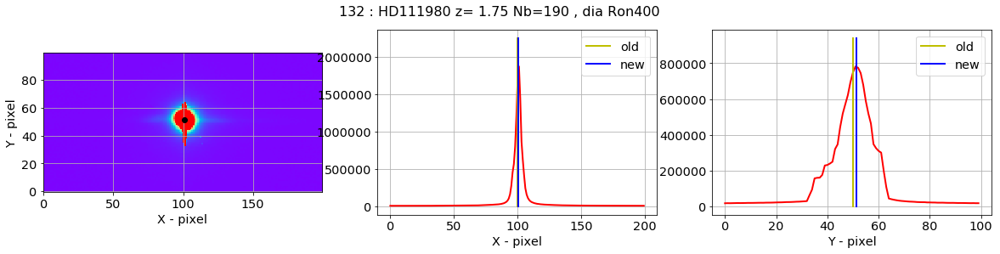

In [90]:
new_x_guess,new_y_guess=check_central_star(all_images,x_guess,y_guess,all_titles,all_filt,Dx=100,Dy=50)

### Check corrections of the center

In [91]:
dx_guess=new_x_guess-x_guess
dy_guess=new_y_guess-y_guess

Text(0.5,0,u'dy - pixel')

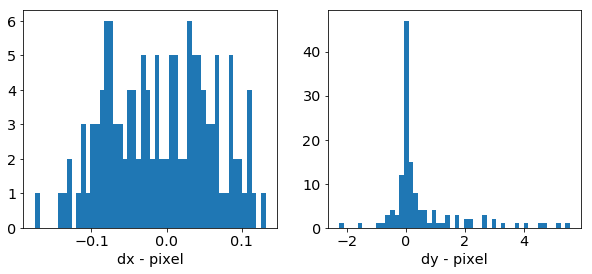

In [92]:
f, (ax1, ax2) = plt.subplots(1,2, figsize=(10,4))
ax1.hist(dx_guess,bins=50);
ax1.set_xlabel("dx - pixel")
ax2.hist(dy_guess,bins=50);
ax2.set_xlabel("dy - pixel")

In [93]:
x_guess=new_x_guess
y_guess=new_y_guess

## Save x_guess, y_guess in a file

In [94]:
ar = {'x_guess' : x_guess, 'y_guess' : y_guess}
df = pd.DataFrame(ar)

In [95]:
df.head()

,x_guess,y_guess
0,1030.025465,1020.398734
1,778.059753,701.467092
2,780.418868,702.197768
3,780.180103,702.117571
4,780.161781,700.943758


In [96]:
df.tail()

,x_guess,y_guess
128,717.250929,689.984322
129,717.090191,688.666563
130,717.444829,688.193847
131,715.847791,688.854895
132,715.693149,689.203533


In [97]:
df.describe()

,x_guess,y_guess
count,133.000000,133.000000
mean,752.100682,691.763019
std,30.772540,29.303637
min,715.693149,681.794928
25%,732.498563,684.397877
50%,750.145394,687.708645
75%,766.684859,693.639878
max,1030.025465,1020.398734


In [98]:
df.to_csv('x_y_guess.csv')

In [99]:
df

,x_guess,y_guess
0,1030.025465,1020.398734
1,778.059753,701.467092
2,780.418868,702.197768
3,780.180103,702.117571
4,780.161781,700.943758
5,780.569659,701.092158
6,780.289254,700.531911
7,778.604031,700.639439
8,778.718737,702.012550
9,777.936607,700.531483


In [100]:
df.to_csv('x_y_guess.csv')

In [101]:
writer = pd.ExcelWriter('x_y_guess.xlsx')
sheet_name=object_name+'_'+date
df.to_excel(writer,sheet_name)
writer.save()

## Finally cut image

- before rotation

- cut the image around the spectra
- the width in Y is DeltaY=100 pixel above and down

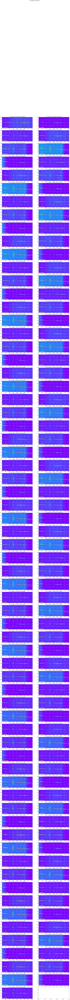

In [102]:
DeltaY=[200]*len(all_images) # put to 200 because background goes far
DeltaX=[2000]*len(all_images)  # must be very large to have correct x positions

images_raw=ShowCenterImages(x_guess,y_guess,DeltaX,DeltaY,all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=2000,target_pos=np.array([x_guess,y_guess]).T)
figfilename=os.path.join(dir_top_images,'cut_images.pdf')
plt.savefig(figfilename)   

## Save cut images
------------------------

- save the series of cut images called **images_raw** in a file


In [103]:
newfullfilenames=[]
for idx,f in np.ndenumerate(sorted_files):
    short_infilename=f.split("/")[-1]
    short_partfilename=re.findall('^%s_(.*)' % tag,short_infilename)
    short_outfilename='cutimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)
    
for idx,f in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=images_raw[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(f,overwrite=True)

In [104]:
!ls -l cut_fitsimages_2/*

-rw-r--r-- 1 dagoret lsst 6566400 Mar  7 14:31 cut_fitsimages_2/cutimg_20170530_058.fits
-rw-r--r-- 1 dagoret lsst 6566400 Mar  7 14:31 cut_fitsimages_2/cutimg_20170530_059.fits
-rw-r--r-- 1 dagoret lsst 6566400 Mar  7 14:31 cut_fitsimages_2/cutimg_20170530_060.fits
-rw-r--r-- 1 dagoret lsst 6566400 Mar  7 14:31 cut_fitsimages_2/cutimg_20170530_061.fits
-rw-r--r-- 1 dagoret lsst 6566400 Mar  7 14:31 cut_fitsimages_2/cutimg_20170530_062.fits
-rw-r--r-- 1 dagoret lsst 6566400 Mar  7 14:31 cut_fitsimages_2/cutimg_20170530_063.fits
-rw-r--r-- 1 dagoret lsst 6566400 Mar  7 14:31 cut_fitsimages_2/cutimg_20170530_064.fits
-rw-r--r-- 1 dagoret lsst 6566400 Mar  7 14:31 cut_fitsimages_2/cutimg_20170530_065.fits
-rw-r--r-- 1 dagoret lsst 6566400 Mar  7 14:31 cut_fitsimages_2/cutimg_20170530_066.fits
-rw-r--r-- 1 dagoret lsst 6566400 Mar  7 14:31 cut_fitsimages_2/cutimg_20170530_067.fits
-rw-r--r-- 1 dagoret lsst 6566400 Mar  7 14:31 cut_fitsimages_2/cutimg_20170530_068.fits
-rw-r--r-- 1 dagoret 